<a href="https://colab.research.google.com/github/brunasil98/LSTM/blob/master/Project1_A.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd  
from random import random
import numpy as np
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from keras.models import Sequential 

from keras.layers.core import Dense, Activation  
from keras.layers.recurrent import LSTM
from keras.callbacks import EarlyStopping, ModelCheckpoint
import matplotlib.pyplot as plt
import seaborn as sns
import os


import cv2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/HISPC /DATA/TRY/' #'/content/drive/MyDrive/HISPC /DATA/TRY/'
# path = 'TRY/'
all_files = os.listdir(path)
#all_files = all_files[:8]
print(len(all_files))
a = len(all_files)
b = a +1




252


In [ ]:
X_ds  = np.zeros([5,1])
Y_ds  = np.zeros([10000,1])


In [ ]:
for fle  in all_files:

    df = pd.read_csv(path + fle, sep = ',')
    df = df.rename(columns = {'Column1':'Time', 'Column2':'Vm','ICaL':'ICaL','IK1':'IK1','Ikr':'Ikr','IKur':'IKur','INa':'INa'})
    df['Time'] = df['Time']-45000
    df = df.dropna()

    ##################################################################

    look = df.loc[:24999,["Vm"]]
    index = look[look['Vm'] == look['Vm'].min()]
    prime = index.index.values[0]
    l_prime = prime + 10000

    x_ds = df[['ICaL','IK1','IKr','IKur','INa']].iloc[0]
    x_ds = x_ds.to_numpy()
    x_ds = x_ds.reshape((5,1))

    y_ds = df[['Vm']].iloc[prime:l_prime]
    y_ds = y_ds.to_numpy()
    
    if y_ds.shape == (10000,1):
      X_ds = np.append(X_ds,x_ds,axis = 0)
      Y_ds = np.append(Y_ds,y_ds,axis = 0)
      # print(Y_ds.shape)

######################### ADD_DATA ###############################

    look = df.loc[25000:49000,["Vm"]]
    index = look[look['Vm'] == look['Vm'].min()]
    prime = index.index.values[0]
    l_prime = prime + 10000

    x_ds = df[['ICaL','IK1','IKr','IKur','INa']].iloc[0]
    x_ds = x_ds.to_numpy()
    x_ds = x_ds.reshape((5,1))

    y_ds = df[['Vm']].iloc[prime:l_prime]
    y_ds = y_ds.to_numpy()
    
   
    if y_ds.shape == (10000,1):
      X_ds = np.append(X_ds,x_ds,axis = 0)
      Y_ds = np.append(Y_ds,y_ds,axis = 0)
      # print(Y_ds.shape)
######################## ADD_DATA ###############################

    look = df.loc[50000:74999,["Vm"]]
    index = look[look['Vm'] == look['Vm'].min()]
    prime = index.index.values[0]
    l_prime = prime + 10000

    x_ds = df[['ICaL','IK1','IKr','IKur','INa']].iloc[0]
    x_ds = x_ds.to_numpy()
    x_ds = x_ds.reshape((5,1))

    y_ds = df[['Vm']].iloc[prime:l_prime]
    y_ds = y_ds.to_numpy()
    

    if y_ds.shape == (10000,1):
      X_ds = np.append(X_ds,x_ds,axis = 0)
      Y_ds = np.append(Y_ds,y_ds,axis = 0)
      # print(Y_ds.shape)

print(Y_ds.shape)

(7570000, 1)


In [ ]:
X_ds = X_ds.reshape((757,5))
Y_ds = Y_ds.reshape((757,10000))
print(X_ds.shape)
print(Y_ds.shape)


(757, 5)
(757, 10000)


In [ ]:
# X_ds = X_ds.reshape((25,5))
# Y_ds = Y_ds.reshape((25,10000))
# print(X_ds.shape)
# print(Y_ds.shape)


In [ ]:
X_ds = np.delete(X_ds,0,0)
Y_ds = np.delete(Y_ds,0,0)
print(X_ds.shape)
print(Y_ds.shape)

(756, 5)
(756, 10000)


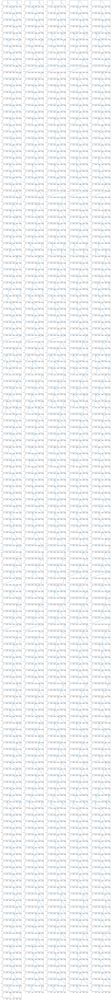

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 160  # number of rows
b = 5  # number of columns
c = 1  # initialize plot counter
for i in range(X_ds.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(Y_ds[i])
    c = c + 1
    
plt.show()

In [ ]:
x1 = pd.DataFrame(X_ds[2])
y1 = pd.DataFrame(Y_ds[2])
UU = pd.concat([x1,y1],axis=1)
UU

,0,0
0,0.0,-70.804051
1,1.0,-70.804046
2,1.0,-70.804035
3,1.0,-70.804020
4,1.0,-70.803999
...,...,...
9995,NaN,-67.870470
9996,NaN,-67.880145
9997,NaN,-67.889797
9998,NaN,-67.899428


In [ ]:
# X_ds = X_ds.reshape((24,1,5))
# Y_ds = Y_ds.reshape((24,1,10000))
# X_train, X_test, y_train, y_test = train_test_split(X_ds, Y_ds, test_size=0.1)

In [ ]:
X_ds = X_ds.reshape((756,1,5))
Y_ds = Y_ds.reshape((756,1,10000))
X_train, X_test, y_train, y_test = train_test_split(X_ds, Y_ds, test_size=0.1, random_state = 360)


In [ ]:
# X_train = X_train[:10]
# y_train = y_train[:10]
# print(X_train.shape)
# print(y_train.shape)


In [ ]:
out_neurons = 12000
hidden_neurons = 12000
hidden_neurons_2 = 10000

#New applicance
model = Sequential()  

model.add(LSTM(out_neurons, input_dim=5, return_sequences=True)) 
# model.add(LSTM(hidden_neurons_2,input_dim=hidden_neurons))
model.add(Dense(hidden_neurons, input_dim=out_neurons))
model.add(Dense(hidden_neurons_2))


model.compile(loss='mean_squared_error', optimizer="RMSprop")

es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 



In [ ]:
print(model.summary())


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, None, 12000)       576288000 
                                                                 
 dense (Dense)               (None, None, 12000)       144012000 
                                                                 
 dense_1 (Dense)             (None, None, 10000)       120010000 
                                                                 
Total params: 840,310,000
Trainable params: 840,310,000
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
#model trainig with 80 epochs
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 268s 3s/step - loss: 954.5153 - val_loss: 983.2828
Epoch 2/80
85/85 [==============================] - 315s 4s/step - loss: 784.6363 - val_loss: 835.9207
Epoch 3/80
85/85 [==============================] - 369s 4s/step - loss: 725.7979 - val_loss: 674.0516
Epoch 4/80
85/85 [==============================] - 363s 4s/step - loss: 698.0887 - val_loss: 695.4673
Epoch 5/80
85/85 [==============================] - 339s 4s/step - loss: 690.6345 - val_loss: 665.6757
Epoch 6/80
85/85 [==============================] - 334s 4s/step - loss: 663.5799 - val_loss: 700.3708
Epoch 7/80
85/85 [==============================] - 352s 4s/step - loss: 643.5941 - val_loss: 654.6254
Epoch 8/80
85/85 [==============================] - 337s 4s/step - loss: 641.5909 - val_loss: 814.2791
Epoch 9/80
85/85 [==============================] - 346s 4s/step - loss: 626.6786 - val_loss: 621.7665
Epoch 10/80
85/85 [==============================] - 341s 4s/step - loss:

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_80.h5') 


In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  274.0471496582031


In [ ]:
x1 = pd.DataFrame(X_test[46])
x1

,0,1,2,3,4
0,2.0,1.0,2.0,2.0,1.0


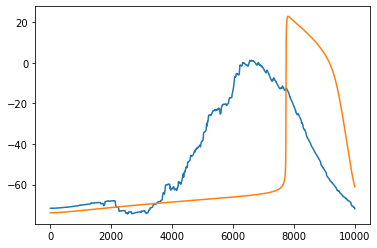

In [ ]:
cmon = np.array([[[1,1,0.6,0.6,0.6]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[46].T)
  
plt.show()

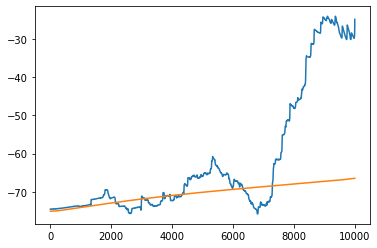

In [ ]:
plt.plot(predicted[44].T)
plt.plot(y_test[44].T)
  
plt.show()

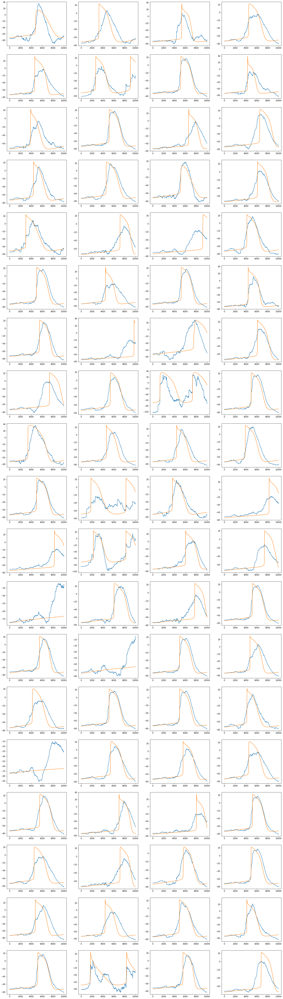

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    
plt.show()

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_80.h5')

In [ ]:
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 

In [ ]:
# Fit the other 80 neurons
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 299s 3s/step - loss: 242.7538 - val_loss: 241.7778
Epoch 2/80
85/85 [==============================] - 298s 3s/step - loss: 241.8969 - val_loss: 232.2212
Epoch 3/80
85/85 [==============================] - 325s 4s/step - loss: 236.0131 - val_loss: 223.4385
Epoch 4/80
85/85 [==============================] - 348s 4s/step - loss: 233.3397 - val_loss: 220.8216
Epoch 5/80
85/85 [==============================] - 382s 5s/step - loss: 233.5046 - val_loss: 240.2947
Epoch 6/80
85/85 [==============================] - 392s 5s/step - loss: 233.5670 - val_loss: 217.6144
Epoch 7/80
85/85 [==============================] - 373s 4s/step - loss: 232.5540 - val_loss: 227.8438
Epoch 8/80
85/85 [==============================] - 394s 5s/step - loss: 231.4001 - val_loss: 213.5132
Epoch 9/80
85/85 [==============================] - 415s 5s/step - loss: 230.6891 - val_loss: 216.2563
Epoch 10/80
85/85 [==============================] - 388s 5s/step - loss:

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_160.h5') 


In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  148.41818237304688


In [ ]:
x1 = pd.DataFrame(X_test[46])
x1

,0,1,2,3,4
0,1.0,1.0,2.0,1.0,2.0


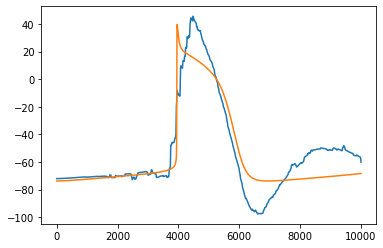

In [ ]:
cmon = np.array([[[1,1,2,1,2]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[46].T)
  
plt.show()

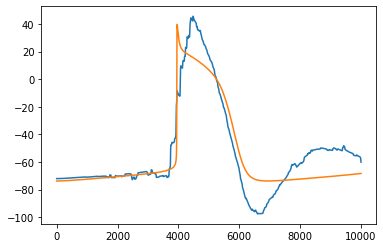

In [ ]:
plt.plot(predicted[46].T)
plt.plot(y_test[46].T)
  
plt.show()

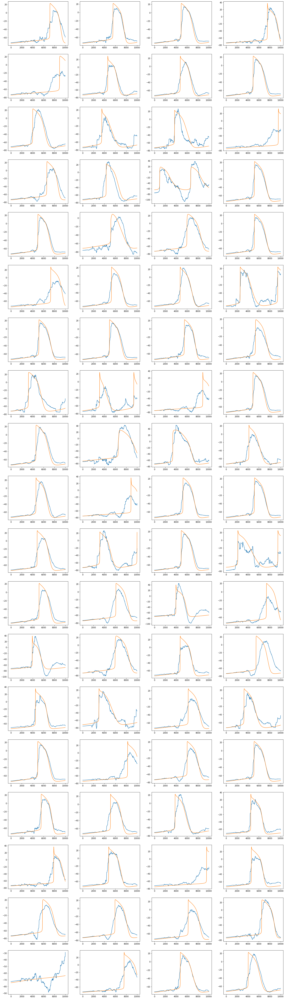

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_160.h5')

In [ ]:
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 

In [ ]:
# Fit the other 80 neurons
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 325s 4s/step - loss: 142.2112 - val_loss: 159.2937
Epoch 2/80
85/85 [==============================] - 327s 4s/step - loss: 142.4118 - val_loss: 209.8206
Epoch 3/80
85/85 [==============================] - 345s 4s/step - loss: 141.7596 - val_loss: 143.0800
Epoch 4/80
85/85 [==============================] - 349s 4s/step - loss: 141.1448 - val_loss: 182.0632
Epoch 5/80
85/85 [==============================] - 359s 4s/step - loss: 138.3397 - val_loss: 144.1776
Epoch 6/80
85/85 [==============================] - 346s 4s/step - loss: 140.1127 - val_loss: 132.1124
Epoch 7/80
85/85 [==============================] - 355s 4s/step - loss: 136.1549 - val_loss: 162.3326
Epoch 8/80
85/85 [==============================] - 356s 4s/step - loss: 140.3140 - val_loss: 164.8055
Epoch 9/80
85/85 [==============================] - 356s 4s/step - loss: 136.6950 - val_loss: 143.2176
Epoch 10/80
85/85 [==============================] - 360s 4s/step - loss:

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_240.h5') 

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  126.61750793457031


In [ ]:
x1 = pd.DataFrame(X_test[75])
x1

,0,1,2,3,4
0,1.0,1.0,1.0,0.4,1.0


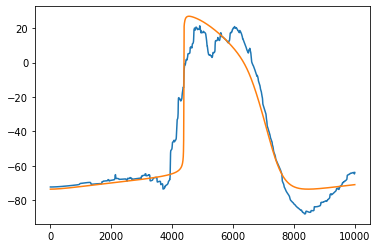

In [ ]:
cmon = np.array([[[1.0,	1.0,1.0,0.4,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

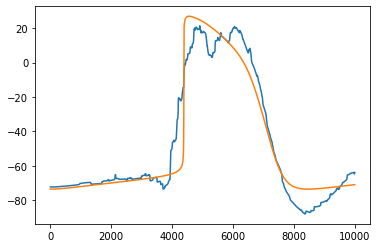

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

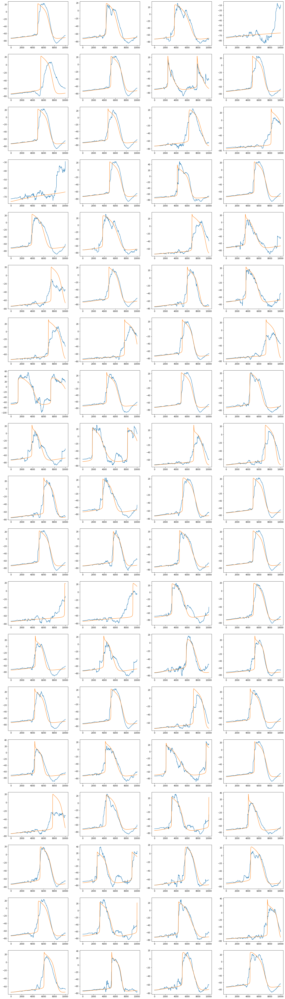

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    

9

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_240.h5')

In [ ]:
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 

In [ ]:
# Fit the other 80 neurons
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

In [ ]:
# Fit the other 80 neurons
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 344s 4s/step - loss: 102.3298 - val_loss: 85.1174
Epoch 2/80
85/85 [==============================] - 343s 4s/step - loss: 101.6315 - val_loss: 82.2315
Epoch 3/80
 7/85 [=>............................] - ETA: 4:11 - loss: 86.4041

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_320.h5') 

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  79.46097564697266


In [ ]:
x1 = pd.DataFrame(X_test[75])
x1

,0,1,2,3,4
0,1.0,0.6,1.0,0.6,1.0


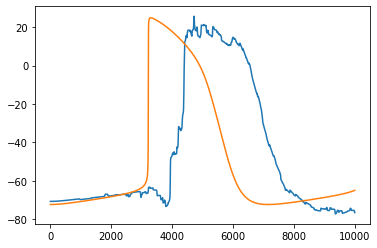

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

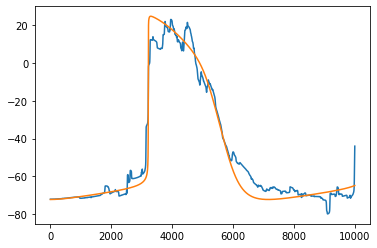

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

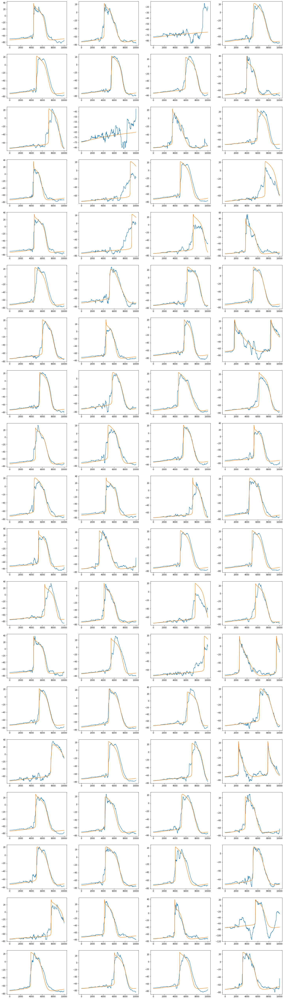

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_320.h5')



In [ ]:
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test_400.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 311s 4s/step - loss: 86.0583 - val_loss: 79.2479
Epoch 2/80
85/85 [==============================] - 301s 4s/step - loss: 84.9312 - val_loss: 85.5825
Epoch 3/80
85/85 [==============================] - 308s 4s/step - loss: 86.4393 - val_loss: 91.4313
Epoch 4/80
85/85 [==============================] - 326s 4s/step - loss: 84.9577 - val_loss: 77.8185
Epoch 5/80
85/85 [==============================] - 342s 4s/step - loss: 83.7156 - val_loss: 98.8153
Epoch 6/80
85/85 [==============================] - 352s 4s/step - loss: 84.4700 - val_loss: 73.7623
Epoch 7/80
85/85 [==============================] - 349s 4s/step - loss: 84.6553 - val_loss: 103.9819
Epoch 8/80
85/85 [==============================] - 353s 4s/step - loss: 84.0506 - val_loss: 82.9728
Epoch 9/80
85/85 [==============================] - 355s 4s/step - loss: 84.2336 - val_loss: 87.0157
Epoch 10/80
85/85 [==============================] - 351s 4s/step - loss: 82.0399 - val_lo

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_400.h5') 

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  63.34135818481445


In [ ]:
x1 = pd.DataFrame(X_test[75])
x1

,0,1,2,3,4
0,1.0,0.6,1.0,0.6,1.0


In [ ]:
x1 = pd.DataFrame(X_test[75])
x1

,0,1,2,3,4
0,1.0,0.6,1.0,0.6,1.0


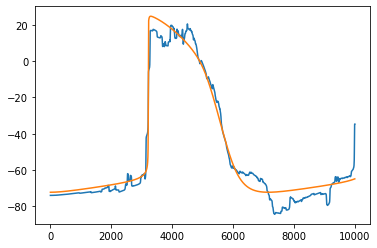

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

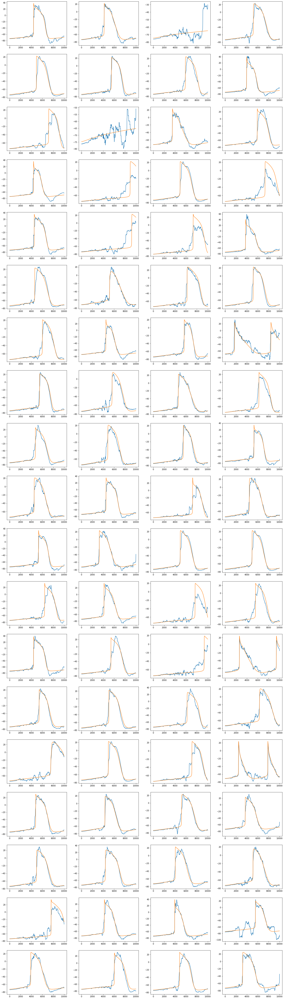

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_400.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test_400.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=80, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/80
85/85 [==============================] - 287s 3s/step - loss: 73.8947 - val_loss: 82.8083
Epoch 2/80
85/85 [==============================] - 294s 3s/step - loss: 71.2087 - val_loss: 70.4831
Epoch 3/80
85/85 [==============================] - 305s 4s/step - loss: 73.1931 - val_loss: 72.3003
Epoch 4/80
85/85 [==============================] - 312s 4s/step - loss: 69.0395 - val_loss: 83.6118
Epoch 5/80
85/85 [==============================] - 321s 4s/step - loss: 72.6006 - val_loss: 70.3861
Epoch 6/80
85/85 [==============================] - 328s 4s/step - loss: 73.9173 - val_loss: 71.7615
Epoch 7/80
85/85 [==============================] - 329s 4s/step - loss: 70.0079 - val_loss: 72.8205
Epoch 8/80
85/85 [==============================] - 325s 4s/step - loss: 71.8845 - val_loss: 67.1756
Epoch 9/80
85/85 [==============================] - 335s 4s/step - loss: 70.9668 - val_loss: 62.1931
Epoch 10/80
85/85 [==============================] - 338s 4s/step - loss: 69.1566 - val_los

OSError: ignored

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_475.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  83.6117935180664


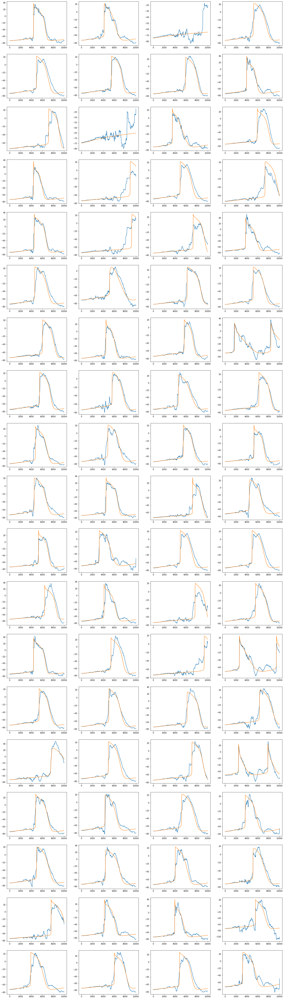

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

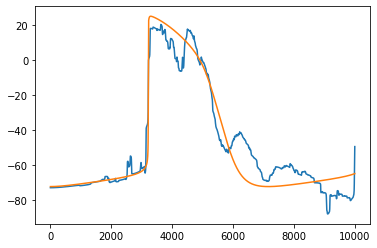

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_475.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=75, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/75
85/85 [==============================] - 298s 3s/step - loss: 71.3725 - val_loss: 63.3489
Epoch 2/75
85/85 [==============================] - 295s 3s/step - loss: 71.0072 - val_loss: 70.2317
Epoch 3/75
85/85 [==============================] - 321s 4s/step - loss: 70.9745 - val_loss: 73.3157
Epoch 4/75
85/85 [==============================] - 339s 4s/step - loss: 70.3105 - val_loss: 74.4574
Epoch 5/75
85/85 [==============================] - 342s 4s/step - loss: 72.4769 - val_loss: 68.0740
Epoch 6/75
85/85 [==============================] - 354s 4s/step - loss: 70.9062 - val_loss: 76.7206
Epoch 7/75
85/85 [==============================] - 348s 4s/step - loss: 70.8963 - val_loss: 63.0667
Epoch 8/75
85/85 [==============================] - 343s 4s/step - loss: 70.6555 - val_loss: 65.4494
Epoch 9/75
85/85 [==============================] - 336s 4s/step - loss: 70.8555 - val_loss: 72.3421
Epoch 10/75
85/85 [==============================] - 350s 4s/step - loss: 69.7642 - val_los

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_550.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  67.27671813964844


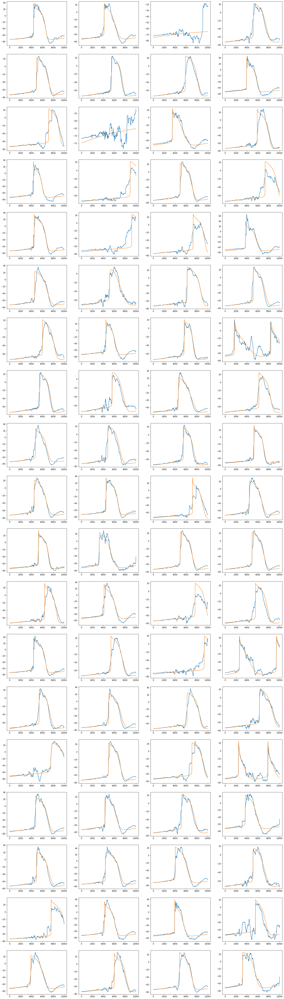

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

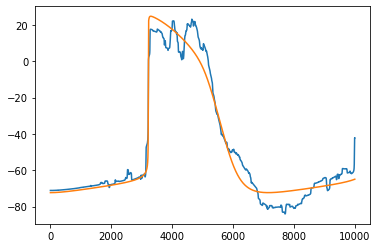

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

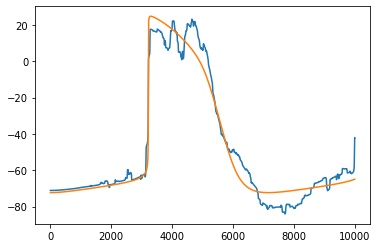

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_550.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=50, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/50
85/85 [==============================] - 286s 3s/step - loss: 63.4833 - val_loss: 73.6191
Epoch 2/50
85/85 [==============================] - 286s 3s/step - loss: 64.0463 - val_loss: 57.1307
Epoch 3/50
85/85 [==============================] - 260s 3s/step - loss: 63.1616 - val_loss: 54.2339
Epoch 4/50
85/85 [==============================] - 292s 3s/step - loss: 63.5292 - val_loss: 60.2316
Epoch 5/50
85/85 [==============================] - 300s 4s/step - loss: 63.5784 - val_loss: 56.1391
Epoch 6/50
85/85 [==============================] - 296s 3s/step - loss: 64.0059 - val_loss: 65.7250
Epoch 7/50
85/85 [==============================] - 294s 3s/step - loss: 61.8405 - val_loss: 66.2308
Epoch 8/50
85/85 [==============================] - 280s 3s/step - loss: 63.9773 - val_loss: 63.4629
Epoch 9/50
85/85 [==============================] - 280s 3s/step - loss: 62.4122 - val_loss: 85.4686
Epoch 10/50
85/85 [==============================] - 283s 3s/step - loss: 62.0164 - val_los

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_700.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  53.5180778503418


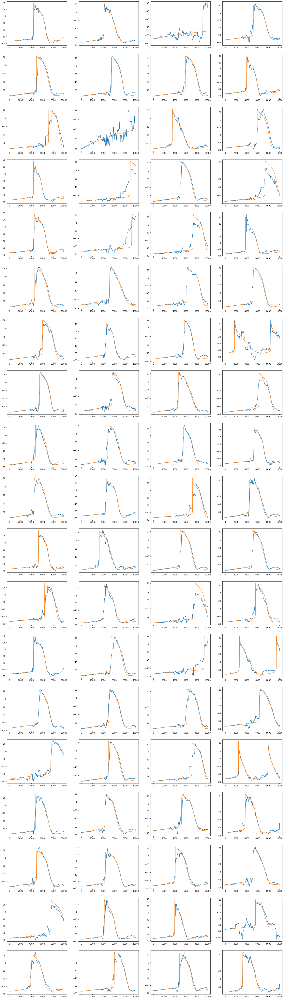

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

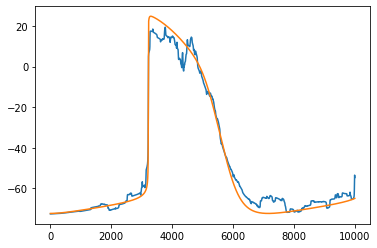

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

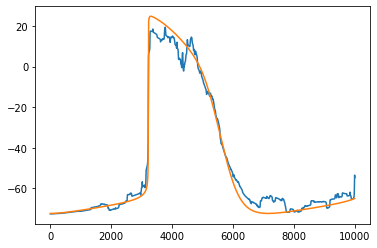

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_700.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=50, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/50
85/85 [==============================] - 286s 3s/step - loss: 58.9535 - val_loss: 57.6912
Epoch 2/50
85/85 [==============================] - 303s 4s/step - loss: 59.7044 - val_loss: 57.9658
Epoch 3/50
85/85 [==============================] - 300s 4s/step - loss: 59.7323 - val_loss: 58.6626
Epoch 4/50
85/85 [==============================] - 294s 3s/step - loss: 59.5679 - val_loss: 65.5085
Epoch 5/50
85/85 [==============================] - 307s 4s/step - loss: 58.4021 - val_loss: 51.9443
Epoch 6/50
85/85 [==============================] - 333s 4s/step - loss: 59.6825 - val_loss: 60.2924
Epoch 7/50
85/85 [==============================] - 344s 4s/step - loss: 59.2256 - val_loss: 49.6400
Epoch 8/50
85/85 [==============================] - 330s 4s/step - loss: 58.4887 - val_loss: 88.0447
Epoch 9/50
85/85 [==============================] - 371s 4s/step - loss: 58.2468 - val_loss: 68.0925
Epoch 10/50
85/85 [==============================] - 358s 4s/step - loss: 58.3199 - val_los

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_750.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  57.842586517333984


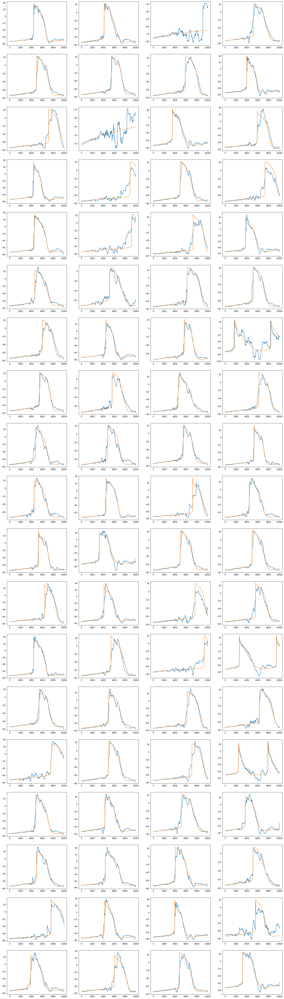

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

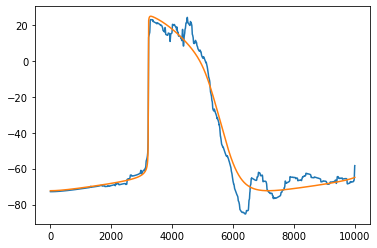

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

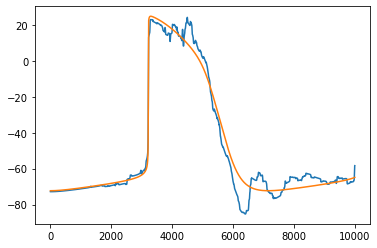

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
x = 2 +3
x

5

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_750.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=50, validation_data=[X_test,y_test], callbacks=[es_monitor])  

Epoch 1/50
85/85 [==============================] - 277s 3s/step - loss: 55.0354 - val_loss: 61.9289
Epoch 2/50
85/85 [==============================] - 318s 4s/step - loss: 55.3292 - val_loss: 57.0741
Epoch 3/50
85/85 [==============================] - 354s 4s/step - loss: 55.9980 - val_loss: 54.3399
Epoch 4/50
85/85 [==============================] - 333s 4s/step - loss: 56.0816 - val_loss: 49.2180
Epoch 5/50
85/85 [==============================] - 373s 4s/step - loss: 54.9409 - val_loss: 52.8663
Epoch 6/50
85/85 [==============================] - 343s 4s/step - loss: 56.0951 - val_loss: 68.4950
Epoch 7/50
85/85 [==============================] - 366s 4s/step - loss: 56.6524 - val_loss: 49.8308
Epoch 8/50
85/85 [==============================] - 394s 5s/step - loss: 56.4183 - val_loss: 59.0681
Epoch 9/50
85/85 [==============================] - 373s 4s/step - loss: 54.8721 - val_loss: 53.5149
Epoch 10/50
85/85 [==============================] - 355s 4s/step - loss: 54.0099 - val_los

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_800.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(76, 1, 10000)
Evaluate:  60.18852233886719


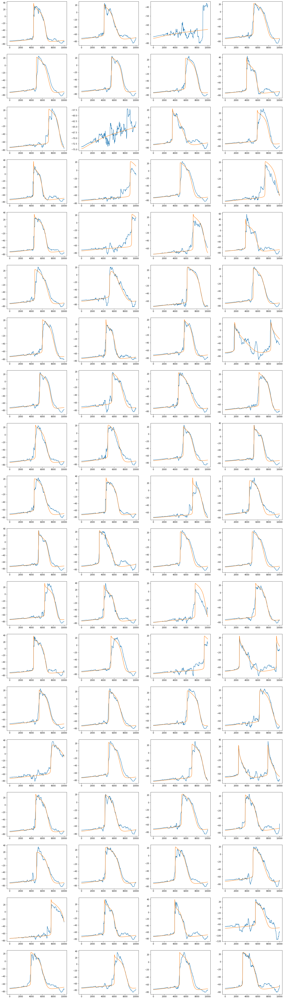

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

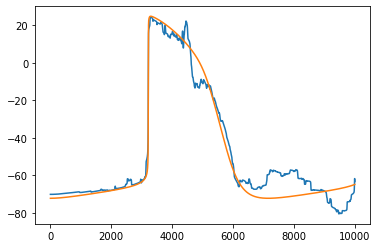

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

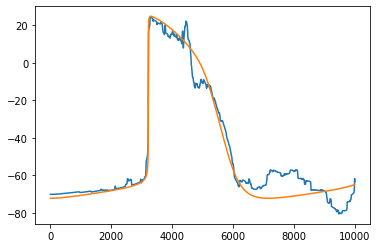

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
from keras.models import load_model
# # # load model
model = load_model(''/content/drive/MyDrive/HISPC /test.h5'')

OSError: ignored

In [ ]:
from keras.models import load_model
# # # load model
model = load_model('/content/drive/MyDrive/HISPC /Complete_800.h5')
es_monitor = [ModelCheckpoint(filepath='/content/drive/MyDrive/HISPC /test.h5') ] 
# Fit the other 80 neurons 
model.fit(X_train, y_train, batch_size=8, epochs=45, validation_data=[X_test,y_test], callbacks=[es_monitor])  

OSError: ignored

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_845.h5')

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1

In [ ]:
plt.plot(predicted[75].T)
plt.plot(y_test[75].T)
  
plt.show()

In [ ]:
cmon = np.array([[[1.0,	0.6,1.0,0.6,1.0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((10000,1))
plt.plot(p_c)
plt.plot(y_test[75].T)
  
plt.show()

# **150 Epochs w 8000 points im MAX values**

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Complete_150.h5') 

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(51, 1, 8000)
Evaluate:  46.054588317871094


In [ ]:
x1 = pd.DataFrame(X_test[46])
x1
# y1 = pd.DataFrame(y_test[5])
# UU = pd.concat([x1,y1],axis=0)
# UU

,0,1,2,3,4
0,1.0,1.0,0.6,0.6,0.6


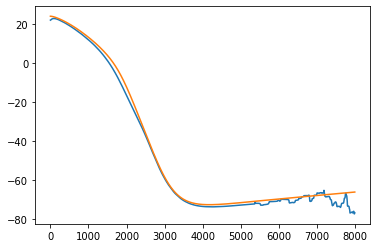

In [ ]:
cmon = np.array([[[1,1,0.6,0.6,0.6]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((8000,1))
plt.plot(p_c)
plt.plot(y_test[46].T)
  
plt.show()

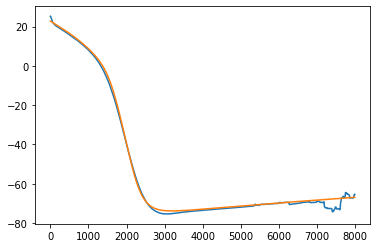

In [ ]:
plt.plot(predicted[5].T)
plt.plot(y_test[5].T)
  
plt.show()

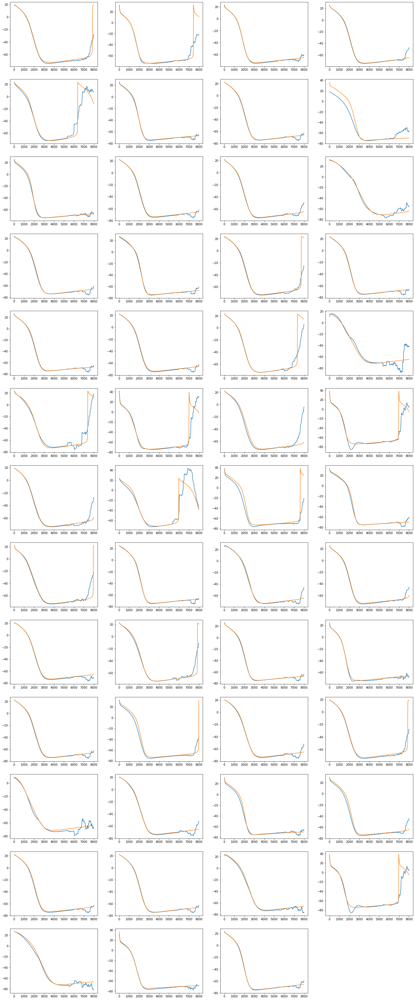

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    
plt.show()

In [ ]:
STOP

# **With Ewarly stop**

In [ ]:
#model hidden 20 and 10
model.fit(X_train, y_train, batch_size=8, epochs=150, validation_data=[X_test,y_test],callbacks=[es_monitor])  

Epoch 1/150
57/57 [==============================] - 147s 3s/step - loss: 472.7042 - val_loss: 302.4814
Epoch 2/150
57/57 [==============================] - 122s 2s/step - loss: 265.0898 - val_loss: 362.7383
Epoch 3/150
57/57 [==============================] - 142s 2s/step - loss: 229.3223 - val_loss: 248.4240
Epoch 4/150
57/57 [==============================] - 155s 3s/step - loss: 196.0665 - val_loss: 194.6371
Epoch 5/150
57/57 [==============================] - 153s 3s/step - loss: 176.2367 - val_loss: 152.7247
Epoch 6/150
57/57 [==============================] - 137s 2s/step - loss: 172.9100 - val_loss: 162.6455
Epoch 7/150
57/57 [==============================] - 156s 3s/step - loss: 168.1372 - val_loss: 143.9581
Epoch 8/150
57/57 [==============================] - 137s 2s/step - loss: 163.1762 - val_loss: 212.2666
Epoch 9/150
57/57 [==============================] - 133s 2s/step - loss: 158.3841 - val_loss: 331.1405
Epoch 10/150
57/57 [==============================] - 140s 2s/st

In [ ]:
model.save('/content/drive/MyDrive/HISPC /Total_8000_150.h5') 

In [ ]:
# from keras.models import load_model
# # # load model
# model = load_model('/content/drive/MyDrive/HISPC /Model_MAX_20000.h5')

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)

(51, 1, 8000)
Evaluate:  143.9581298828125


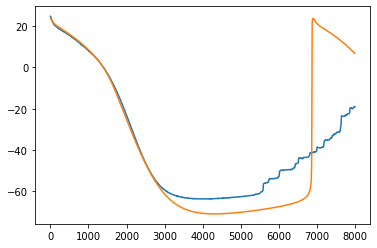

In [ ]:
plt.plot(predicted[5].T)
plt.plot(y_test[5].T)
  
plt.show()

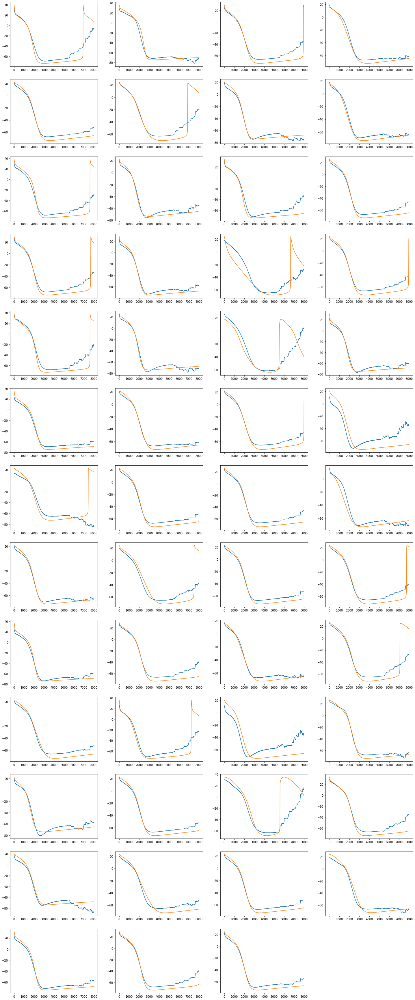

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    
plt.show()

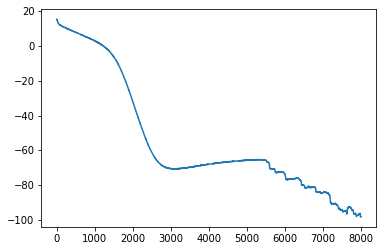

In [ ]:
cmon = np.array([[[1,1,1,1,0]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((8000,1))
plt.plot(p_c)

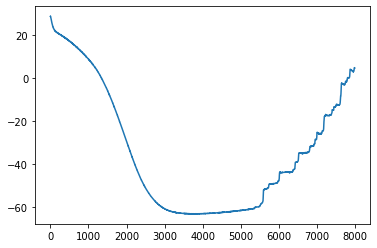

In [ ]:
cmon = np.array([[[1,1,1,1,1]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((8000,1))
plt.plot(p_c)

In [ ]:
#model hidden 20 and 10
model.fit(X_train, y_train, batch_size=8, epochs=150, validation_data=[X_test,y_test],callbacks=[es_monitor])  

Epoch 1/150
57/57 [==============================] - 116s 2s/step - loss: 1192.4003 - val_loss: 943.5006
Epoch 2/150
57/57 [==============================] - 117s 2s/step - loss: 1020.4449 - val_loss: 840.7073
Epoch 3/150
57/57 [==============================] - 106s 2s/step - loss: 996.9525 - val_loss: 1128.0631
Epoch 4/150
57/57 [==============================] - 107s 2s/step - loss: 999.8460 - val_loss: 1104.6765
Epoch 5/150
57/57 [==============================] - 106s 2s/step - loss: 992.8622 - val_loss: 1093.4731
Epoch 6/150
57/57 [==============================] - 105s 2s/step - loss: 996.9793 - val_loss: 928.5268
Epoch 7/150
57/57 [==============================] - 105s 2s/step - loss: 992.4739 - val_loss: 1080.7046
Epoch 8/150
57/57 [==============================] - 104s 2s/step - loss: 982.4655 - val_loss: 1021.5594
Epoch 9/150
57/57 [==============================] - 105s 2s/step - loss: 975.7149 - val_loss: 911.5607
Epoch 10/150
57/57 [==============================] - 103

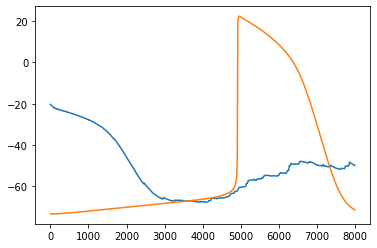

In [ ]:
plt.plot(predicted[5].T)
plt.plot(y_test[5].T)
  
plt.show()

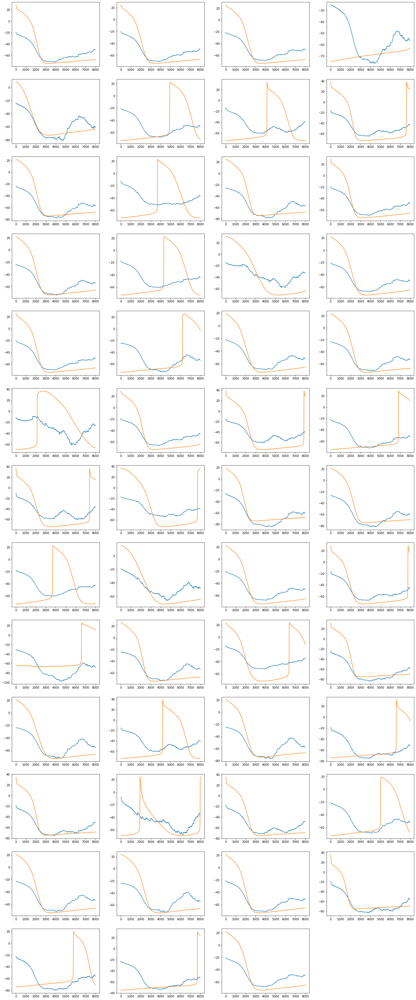

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    # predicted[i] = predicted[i].reshape((8000,1))
    # y_test[i] = y_test[i].reshape((8000,1))
    plt.plot(predicted[i].T)
    plt.plot(y_test[i].T)
    
    c = c + 1
    
plt.show()

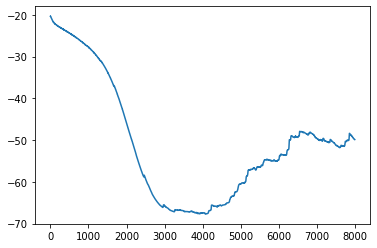

In [ ]:
cmon = np.array([[[1,1,1,1,1]]])
p_c= model.predict(cmon)
p_c = p_c.reshape((8000,1))
plt.plot(p_c)

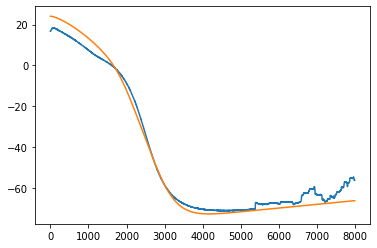

In [ ]:
# predicted[5] = predicted[5].reshape((8000,1))
# y_test[5] = y_test[5].reshape((8000,1))
plt.plot(predicted[5].T)
plt.plot(y_test[5].T)
  
plt.show()

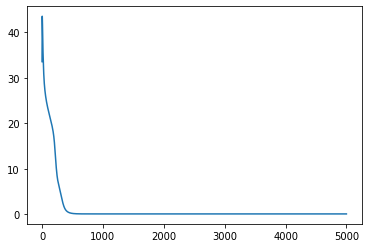

In [ ]:
cmon = np.array([[[1,0.4,1,1,1]]])
n = 1
n2 = 5000
results = []

for x in range(n2):
  p_c= model.predict(cmon)
  results.append(p_c[-1,-1,-1])
  new_cm = cmon[:,-1,:]
  new_cm = new_cm.reshape((1,1,6))
  new_cm[-1,-1,-1] = p_c[-1,-1,-1]
  cmon = np.append(cmon,new_cm,axis = 1)
  n += 1
  cmon = cmon.reshape((1,n,6))
  
plt.plot(results)


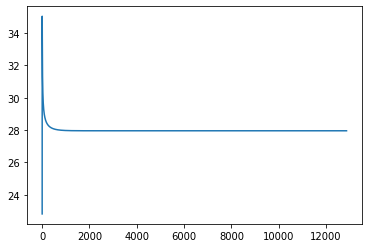

In [ ]:
plt.plot(results) # aroudn 13000 points

### **Model W 15000 Point Data**

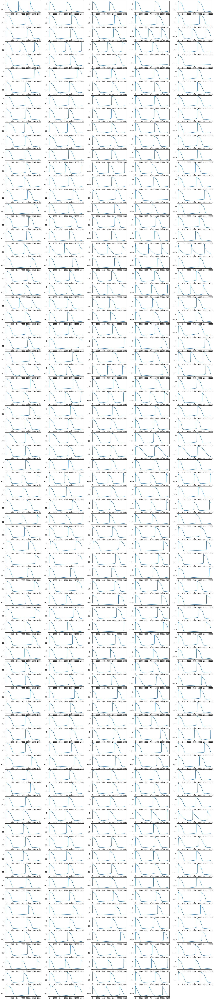

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 150  # number of rows
b = 5  # number of columns
c = 1  # initialize plot counter
for i in range(X_ds.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(Y_ds[i])
    c = c + 1
    
plt.show()

[[[  1.           1.           1.           1.           1.
   -41.79573822]]]
[[[  1.           1.           1.           1.           1.
   -48.16979218]]]
[[[  1.           1.           1.           1.           1.
   -49.49991608]]]
[[[  1.           1.           1.           1.           1.
   -49.02589417]]]
[[[  1.           1.           1.           1.           1.
   -47.83017349]]]
[[[  1.          1.          1.          1.          1.
   -46.2047081]]]
[[[  1.           1.           1.           1.           1.
   -44.07765961]]]
[[[  1.           1.           1.           1.           1.
   -41.05908585]]]
[[[  1.           1.           1.           1.           1.
   -36.73266983]]]
[[[  1.           1.           1.           1.           1.
   -30.35818291]]]
[[[  1.           1.           1.           1.           1.
   -21.09307671]]]
[[[ 1.          1.          1.          1.          1.
   -9.17411709]]]
[[[1.         1.         1.         1.         1.         2.815

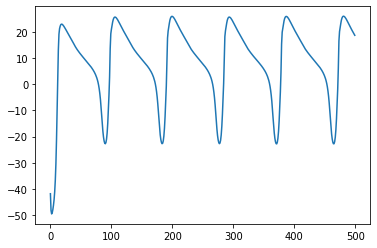

In [ ]:
cmon = np.array([[[1,0.3,1,1,1,-43.0]]])
add = np.array([[[1,1,1,1,1,0.0]]])
n= 1
n2 = 500


for x in range(n2):
  p_c= model.predict(cmon)
  add[-1,-1,-1] = p_c[-1,-1,-1]
  print(add)
  cmon = np.append(cmon,add,axis = 1)
  n += 1
  cmon = cmon.reshape((1,n,6))
  

p_c = p_c.reshape((n2,1))
plt.plot(p_c)

## **Model W Same Start Point**

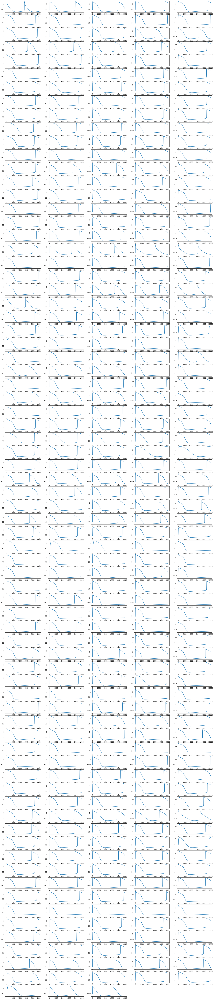

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 150  # number of rows
b = 5  # number of columns
c = 1  # initialize plot counter
for i in range(X_ds.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(Y_ds[i])
    c = c + 1
    
plt.show()
    

In [ ]:
###########  model.save('/content/drive/MyDrive/HISPC /Model_w_Same_Location.h5')   #############

In [ ]:
from keras.models import load_model
# # load model
model = load_model('/content/drive/MyDrive/HISPC /Model_w_Same_Location.h5')

In [ ]:
cmon = np.array([[[1,0.4,1,1,1,19.8]]])
n = 1
n2 = 10000
results = []

for x in range(n2):
  p_c= model.predict(cmon)
  results.append(p_c[-1,-1,-1])
  new_cm = cmon[:,-1,:]
  new_cm = new_cm.reshape((1,1,6))
  new_cm[-1,-1,-1] = p_c[-1,-1,-1]
  cmon = np.append(cmon,new_cm,axis = 1)
  n += 1
  cmon = cmon.reshape((1,n,6))
  
plt.plot(results)


KeyboardInterrupt: ignored

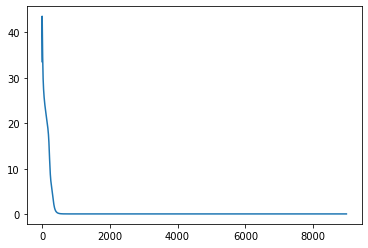

In [ ]:
plt.plot(results)

In [ ]:
len(results)

8985

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)
# print("accuracy score: ", accuracy_score( y_test, predicted))
# print('accuracy: ', accuracy)

(74, 10000, 1)
Evaluate:  0.08026591688394547


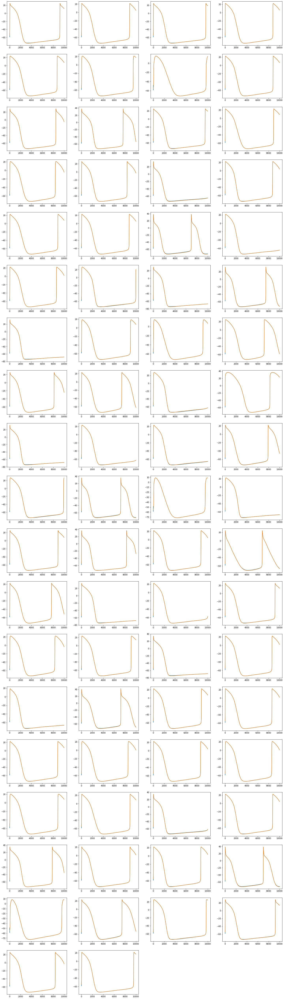

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    plt.plot(y_test[i])
    
    c = c + 1
    
plt.show()

In [ ]:
cmon = np.array([[[1,0.3,1,1,1,-43.0]]])
add = np.array([[[1,1,1,1,1,0.0]]])
n= 1
n2 - 500

In [ ]:
for x in range(n2):
  p_c= model.predict(cmon)
  add[-1,-1,-1] = p_c[-1,-1,-1]
  print(add)
  cmon = np.append(cmon,add,axis = 1)
  n += 1
  cmon = cmon.reshape((1,n,6))
  

p_c = p_c.reshape((n2,1))

[[[  1.           1.           1.           1.           1.
   -48.88513184]]]
[[[  1.           1.           1.           1.           1.
   -56.36471939]]]
[[[  1.           1.           1.           1.           1.
   -57.58036423]]]
[[[  1.           1.           1.           1.           1.
   -57.19556427]]]
[[[  1.           1.           1.           1.           1.
   -56.30063629]]]
[[[  1.           1.           1.           1.           1.
   -55.16397858]]]
[[[  1.           1.           1.           1.           1.
   -53.78469849]]]
[[[  1.           1.           1.           1.           1.
   -52.04701614]]]
[[[  1.           1.           1.           1.           1.
   -49.79353333]]]
[[[  1.           1.           1.           1.           1.
   -46.85217285]]]
[[[  1.           1.           1.           1.           1.
   -43.08415985]]]
[[[  1.           1.           1.           1.           1.
   -38.38077164]]]
[[[  1.           1.           1.           1.      

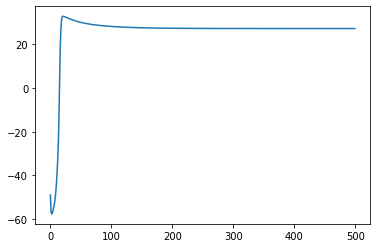

In [ ]:
plt.plot(p_c)

## **Model with Early_stop**
hidenn = 20, 12

In [ ]:
#####     model.save('/content/drive/MyDrive/HISPC /Model_w_stop.h5')  #########

In [ ]:
from keras.models import load_model
# # load model
model = load_model('/content/drive/MyDrive/HISPC /Model_w_stop.h5')

In [ ]:
cmon = np.array([[[1,0.3,1,1,1,-43.0]]])
add = np.array([[[1,1,1,1,1,0.0]]])
n= 1

In [ ]:
n2 = 500
for x in range(n2):
  p_c= model.predict(cmon)
  add[-1,-1,-1] = p_c[-1,-1,-1]
  print(add)
  cmon = np.append(cmon,add,axis = 1)
  n += 1
  cmon = cmon.reshape((1,n,6))
  

p_c = p_c.reshape((n2,1))

[[[ 1.          1.          1.          1.          1.
   -0.98974663]]]
[[[ 1.          1.          1.          1.          1.
   -1.05395627]]]
[[[ 1.          1.          1.          1.          1.
   -1.19111896]]]
[[[ 1.          1.          1.          1.          1.
   -1.31857836]]]
[[[ 1.          1.          1.          1.          1.
   -1.43185258]]]
[[[ 1.          1.          1.          1.          1.
   -1.53139997]]]
[[[ 1.          1.          1.          1.          1.
   -1.61780918]]]
[[[ 1.          1.          1.          1.          1.
   -1.69228649]]]
[[[ 1.          1.          1.          1.          1.
   -1.75635755]]]
[[[ 1.          1.          1.          1.          1.
   -1.81151652]]]
[[[ 1.          1.          1.          1.          1.
   -1.85906196]]]
[[[ 1.          1.          1.          1.          1.
   -1.90007067]]]
[[[ 1.          1.          1.          1.          1.
   -1.93543029]]]
[[[ 1.          1.          1.          1.         

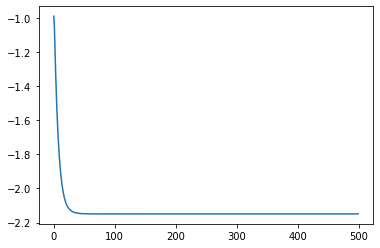

In [ ]:
plt.plot(p_c)

In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)
scores = model.evaluate(X_test, y_test, verbose=0)
print('Evaluate: ', scores)
# print("accuracy score: ", accuracy_score( y_test, predicted))
# print('accuracy: ', accuracy)

In [ ]:
# df_final = pd.DataFrame()
# for i in range(51):
#   df = pd.DataFrame(y_test[i])
#   df2 = pd.DataFrame(predicted[i])
#   df_final = pd.concat([df_final,df,df2],axis = 1)
# df_final

In [ ]:
# fig = plt.figure(figsize = (25,250))
# #  Categorical Data
# a = 51  # number of rows
# b = 4  # number of columns
# c = 1  # initialize plot counter
# for i in range(predicted.shape[0]):
#     plt.subplot(a,b,c)
#     plt.plot(predicted[i])
#     c = c + 1
#     plt.subplot(a,b,c)
#     plt.plot(y_test[i])
#     #plt.title(title[i])
#     c = c + 1
    
# plt.show()

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
predicted2  = np.zeros([10000,1])
y_test2  = np.zeros([10000,1])
X_test2  = np.zeros([10000,6])
for i in range(predicted.shape[0]):
    y_t2 = np.round(y_test[i], decimals = 3)
    predic = np.round(predicted[i], decimals = 3)
    X_t2 = np.round(X_test[i], decimals = 5)
    y_test2 = np.append(y_test2 , y_t2, axis = 0)
    predicted2 = np.append(predicted2,predic, axis = 0)
    X_test2 = np.append(X_test2,X_t2, axis = 0)


print(y_test2.shape)
print(predicted2.shape)
y_test2 = y_test2.reshape((52,10000,1))
predicted2 = predicted2.reshape((52,10000,1))
y_test2 = np.delete(y_test2,0,0)
predicted2 = np.delete(predicted2,0,0)
X_test2 = X_test2.reshape((52,10000,6))
X_test2 = np.delete(X_test2,0,0)
# y_test2 = y_test2.reshape((510000,1))
# predicted2 = predicted2.reshape((510000,1))
# y_test2 = y_test2.reshape((51,10000,1))
# predicted2 = predicted2.reshape((51,10000,1))
print(y_test2.shape)
print(predicted2.shape)
print(X_test2.shape)
# print("accuracy score: ", accuracy_score(y_test2, predicted2))


In [ ]:
df_final = pd.DataFrame()
for i in range(51):
  df = pd.DataFrame(y_test2[i])
  df2 = pd.DataFrame(predicted2[i])
  df_final = pd.concat([df_final,df,df2],axis = 1)
df_final

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted2.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted2[i])
    plt.plot(y_test2[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
predicted3  = np.zeros([9900,1])
y_test3  = np.zeros([9900,1])
for i in range(predicted.shape[0]):
  Y = y_test2[i]
  pre = predicted2[i]
  pre = pre[99:9999,:]
  Y = Y[99:9999:]
  y_test3 = np.append(y_test3, Y,  axis = 0)
  predicted3 = np.append(predicted3, pre, axis = 0)

print(y_test3.shape)
print(predicted3.shape)
y_test3 = y_test3.reshape((52,9900,1))
predicted3 = predicted3.reshape((52,9900,1))
y_test3 = np.delete(y_test3,0,0)
predicted3 = np.delete(predicted3,0,0)
print(y_test3.shape)
print(predicted3.shape)
# print("accuracy score: ", accuracy_score( y_test3, predicted3))

In [ ]:
df_final = pd.DataFrame()
for i in range(51):
  df = pd.DataFrame(y_test3[i])
  df2 = pd.DataFrame(predicted3[i])
  df_final = pd.concat([df_final,df,df2],axis = 1)
df_final

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted3.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted3[i])
    plt.plot(y_test3[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
from keras.models import load_model
# # load model
model = load_model('/content/drive/MyDrive/HISPC /Model_w_stop.h5')

In [ ]:
cmon = np.array([[[1,1,.3,1,1,-73.2]]])
p_cmon  = np.zeros([1,1000,1])
print(cmon)
print(cmon.shape)
print(p_cmon.shape)

In [ ]:
for x in range(1000):
  p_c= model.predict(cmon)
  p_cmon = np.append(p_cmon,p_c,axis = 1)
  cmon[:,:,-1] = p_c[:,:,0]
  print(p_c)
  print(cmon[:,])

In [ ]:
print(p_cmon.shape)

In [ ]:
p_cmon = p_cmon.reshape((2,1000,1))

In [ ]:
for i in range(0,2):  
  plt.plot(p_cmon[i].T)

In [ ]:
print(p_cmon.shape)
p_cmon = p_cmon.reshape((2,10000,1))
p_cmon = np.delete(p_cmon,0,0)
print(p_cmon.shape)
p_cmon = p_cmon.reshape((1,10000))
print(p_cmon.shape)


In [ ]:
plt.plot(p_cmon.T)

## **Model with 80 epochs**
hidenn = 20, 12

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    c = c + 1
    plt.subplot(a,b,c)
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
scores = model.evaluate(X_test, y_test, verbose=0)
scores

## **Model with 80 epochs**
hidenn = 20, 10

In [ ]:
#model hidden 20 and 10
model.fit(X_train, y_train, batch_size=16, epochs=80, validation_split=0.10)  


In [ ]:
predicted = model.predict(X_test)  
print(predicted.shape)

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    c = c + 1
    plt.subplot(a,b,c)
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:

fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
scores = model.evaluate(X_test, y_test, verbose=0)
scores

## **Model with 50 epochs**
hidenn = 20, 10

In [ ]:
fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    c = c + 1
    plt.subplot(a,b,c)
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
scores = model.evaluate(X_test, y_test, verbose=0)
scores

In [ ]:
x1 = pd.DataFrame(predicted[6])
y1 = pd.DataFrame(y_test[6])
UU = pd.concat([x1,y1],axis=1)
UU

In [ ]:

fig = plt.figure(figsize = (25,250))
#  Categorical Data
a = 51  # number of rows
b = 4  # number of columns
c = 1  # initialize plot counter
for i in range(predicted.shape[0]):
    plt.subplot(a,b,c)
    plt.plot(predicted[i])
    plt.plot(y_test[i])
    #plt.title(title[i])
    c = c + 1
    
plt.show()

In [ ]:
# for fle  in all_files:

#     df = pd.read_csv(path + fle, sep = ',')
#     df = df.rename(columns = {'Column1':'Time', 'Column2':'Vm','ICaL':'ICaL','IK1':'IK1','Ikr':'Ikr','IKur':'IKur','INa':'INa'})
#     df['Time'] = df['Time']-45000
#     df = df.dropna()

#     ##################################################################

#     look = df.loc[:49999,["Vm"]]
#     look['Vm'] = look['Vm'].round()
#     look = look.drop_duplicates(subset='Vm', keep='first')
#     index = look[look['Vm'] == -55]
#     prime = index.index.values[0]

    

#     look = look.reset_index(drop=True)    
#     test = look[look['Vm'] == -55]
#     test = test.index.values[0]
#     test = test + 1
#     look = look.iloc[test][0]
#     l_prime = prime + 30000
#     # print(look)
#     if look >= -54:
#       x_ds = df[['ICaL','IK1','IKr','IKur','INa','Vm']].iloc[prime:l_prime]
#       x_ds = x_ds.to_numpy()

#       l_prime = l_prime + 1 
#       prime = prime + 1
#       y_ds = df[['Vm']].iloc[prime:l_prime]
#       y_ds = y_ds.to_numpy()
    
#       X_ds = np.append(X_ds,x_ds,axis = 0)
#       Y_ds = np.append(Y_ds,y_ds,axis = 0)

# ######################### ADD_DATA ###############################

#     look = df.loc[50000:99999,["Vm"]]
#     look['Vm'] = look['Vm'].round()
#     look = look.drop_duplicates(subset='Vm', keep='first')
#     index = look[look['Vm'] == -55]
#     prime = index.index.values[0]



#     look = look.reset_index(drop=True)    
#     test = look[look['Vm'] == -55]
#     test = test.index.values[0]
#     test = test + 1
#     look = look.iloc[test][0]
#     l_prime = prime + 30000
#     #print(look)
#     if look >= -54:
#       x_ds = df[['ICaL','IK1','IKr','IKur','INa','Vm']].iloc[prime:l_prime]
#       x_ds = x_ds.to_numpy()

#       l_prime = l_prime + 1 
#       prime = prime + 1
#       y_ds = df[['Vm']].iloc[prime:l_prime]
#       y_ds = y_ds.to_numpy()
    
#       X_ds = np.append(X_ds,x_ds,axis = 0)
#       Y_ds = np.append(Y_ds,y_ds,axis = 0)

# # ######################### ADD_DATA ###############################

# #     look = df.loc[65000:99999,["Vm"]]
# #     look['Vm'] = look['Vm'].round()
# #     look = look.drop_duplicates(subset='Vm', keep='first')
# #     index = look[look['Vm'] == -58]
# #     prime = index.index.values[0]



# #     look = look.reset_index(drop=True)    
# #     test = look[look['Vm'] == -58]
# #     test = test.index.values[0]
# #     test = test + 1
# #     look = look.iloc[test][0]
# #     l_prime = prime + 12000
# #     #print(look)
# #     if look >= -57:
# #       x_ds = df[['ICaL','IK1','IKr','IKur','INa','Vm']].iloc[prime:l_prime]
# #       x_ds = x_ds.to_numpy()

# #       l_prime = l_prime + 1 
# #       prime = prime + 1
# #       y_ds = df[['Vm']].iloc[prime:l_prime]
# #       y_ds = y_ds.to_numpy()
    
# #       X_ds = np.append(X_ds,x_ds,axis = 0)
# #       Y_ds = np.append(Y_ds,y_ds,axis = 0)




# print(X_ds.shape)
# print(Y_ds.shape)
    

(11100000, 6)
(11100000, 1)
